In [19]:
import numpy as np
import pandas as pd
import os
import difflib
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
import plotly.express as px
from sklearn.decomposition import PCA
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict


#### This project is utilizing unsupervised machine learning techniques to recommend songs based off of what song the user inputs. This was heavily influenced by the recommender projet from earlier in the session and my constant use of the app Spotify. The data is taken from spotify in an open source form. 

### Load Data

In [20]:
data = pd.read_csv('data.csv')
data_artist = pd.read_csv('data_by_artist.csv')
data_genre = pd.read_csv('data_by_genres.csv')
data_year = pd.read_csv('data_by_year.csv')

In [21]:
data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [22]:
data_artist.head()

,mode,count,acousticness,artists,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,9,0.590111,"""Cats"" 1981 Original London Cast",0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5
1,1,26,0.862538,"""Cats"" 1983 Broadway Cast",0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,30.576923,5
2,1,7,0.856571,"""Fiddler On The Roof” Motion Picture Chorus",0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.857143,0
3,1,27,0.884926,"""Fiddler On The Roof” Motion Picture Orchestra",0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.851852,0
4,1,7,0.510714,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,43.000000,5


In [23]:
data_genre.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [24]:
data_year.head()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


### Inspect Data using different visuals

/Users/tannerpacheco/Documents/Masters_Program/Machine Learning - Unsupervised/final_unsupervised/.venv/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations



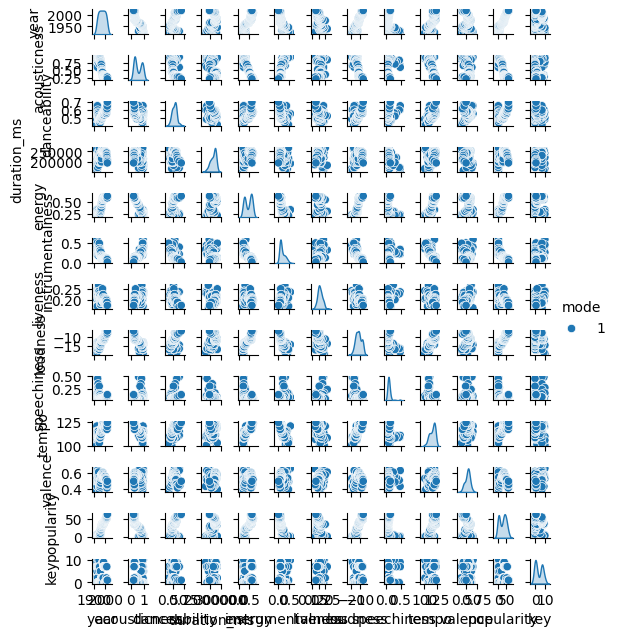

In [41]:
sns.pairplot(data_year, hue='mode', height=.5, aspect=.8)

#### The SNS pairplot is one of the most useful tools for investigating and analyzing how the features relate to one another. Based on the data above we can see trends and basica analysis that will give context and insight into how the data will be best utilized in modeling.

##### The below inspection of data is looking at how popular artists and songs are. The display of data also shows how clean and usable the data is.

In [26]:
top10_artists = data_artist.nlargest(10, 'popularity')
top10_songs = data.nlargest(10, 'popularity')

print("Top Artists:\n", top10_artists['artists'])
print("Top Songs:\n", top10_songs['name'])

Top Artists:
 20966        Ritt Momney
14354          Lele Pons
15070    Los Legendarios
11764           Jerry Di
7463              Emilee
23687          Surf Mesa
28263        salem ilese
213                  A7S
2343             Beltito
14378       Lenny Santos
Name: artists, dtype: object
Top Songs:
 19611                                     Dakiti
19606                     Mood (feat. iann dior)
19618                                   Dynamite
19608            WAP (feat. Megan Thee Stallion)
19610                                  positions
19612                    What You Know Bout Love
19616                            Blinding Lights
19607    For The Night (feat. Lil Baby & DaBaby)
19615             Holy (feat. Chance The Rapper)
19620                 Lonely (with benny blanco)
Name: name, dtype: object


### Create KMeans and TSNE clusters

In [27]:
cluster_pipe = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=12))])
X = data_genre.select_dtypes(np.number)
cluster_pipe.fit(X)
data_genre['cluster'] = cluster_pipe.predict(X)

In [28]:
tsne_pipe = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embed = tsne_pipe.fit_transform(X)
project = pd.DataFrame(columns=['x', 'y'], data=genre_embed)
project['genres'] = data_genre['genres']
project['cluster'] = data_genre['cluster']

fig = px.scatter(project, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'], title='Genre Clusters')
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.003s...
[t-SNE] Computed neighbors for 2973 samples in 0.293s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106262
[t-SNE] KL divergence after 1000 iterations: 1.393938


In [29]:
s_cluster_pipe = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=20, verbose=False, n_init=4))], verbose=False)
X = data.select_dtypes(np.number)
s_cluster_pipe.fit(X)
data['cluster_label'] = s_cluster_pipe.predict(X)

In [30]:
pca_pipe = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embed = pca_pipe.fit_transform(X)
projection = pd.DataFrame(columns=['x','y'], data=song_embed)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'], title="Song Cluster")
fig.show()

#### The two above clusters are not only made via unsupervised learning techniques but are also one of the best ways to show how the wide range songs and genres differ from each other. The plots both utilize the numerical data making up the ID of the songs then is able to cluster them to assess relationship between long song and like genres.
#### As we can see the genres plot is more grouped becuause as assumed before studying genres are made up of like-music

### Create Spotify search and pull

In [31]:
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id="username", client_secret="password"))

def find_song(name, year):
    data_song = defaultdict()
    results = sp.search(q='track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    results = results['tracks']['items'][0]
    trackid = results['id']
    audio_features = sp.audio_features(trackid)[0]

    data_song['name'] = [name]
    data_song['year'] = [year]
    data_song['explicit'] = [int(results['explicit'])]
    data_song['duration_ms'] = [results['duration_ms']]
    data_song['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        data_song[key] = value
    
    return pd.DataFrame(data_song)

### Build Recommender system for Spotify suggested songs

In [32]:
number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

def get_song_data(song, spotify_data):
    try:
        data_song = spotify_data[(spotify_data['name'] == song['name'])
                                 & (spotify_data['year'] == song['year'])].iloc[0]
        return data_song
    
    except IndexError:
        return find_song(song['name'], song['year'])
    
def get_mean_vector(song_list, spotify_data):

    song_vectors = []
    for song in song_list:
        data_song = get_song_data(song, spotify_data)
        if data_song is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = data_song[number_cols].values
        song_vectors.append(song_vector)
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)

    return flattened_dict

def recommend_songs(song_list, spotify_data, n_songs=10):
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    song_center = get_mean_vector(song_list, spotify_data)
    scaler = s_cluster_pipe.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1,-1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    
    return rec_songs[metadata_cols].to_dict(orient='records')

In [33]:
recommend_songs([{'name': 'Money Trees', 'year': 2012}], data)

/Users/tannerpacheco/Documents/Masters_Program/Machine Learning - Unsupervised/final_unsupervised/.venv/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



[{'name': 'Dear Mama', 'year': 1995, 'artists': "['2Pac']"},
 {'name': 'Dark Fantasy', 'year': 2010, 'artists': "['Kanye West']"},
 {'name': 'Novacane', 'year': 2011, 'artists': "['Frank Ocean']"},
 {'name': 'Modern Loneliness', 'year': 2020, 'artists': "['Lauv']"},
 {'name': 'Straight Up Menace', 'year': 2010, 'artists': "['MC Eiht']"},
 {'name': 'wokeuplikethis*',
  'year': 2017,
  'artists': "['Playboi Carti', 'Lil Uzi Vert']"},
 {'name': 'Ladders', 'year': 2018, 'artists': "['Mac Miller']"},
 {'name': 'Kids', 'year': 2011, 'artists': "['Childish Gambino']"}]

### Conclusion

##### One of the most present forms of unsupervised learning in the present day online informational systems is recommender systems. This helps provide everything from the targeted ads we see every day and the pop up navigational instructions we get from our phones. Further and additional studying would show just how good these systems can get at predicting and grouping everyday things we enjoy. 